In [5]:
using PyPlot, SparseArrays, Polynomials, PyCall

In [6]:
@pyimport IPython.display as d
"""
    mkanim(x, allu)

Utility for animating PDE solutions in a Jupyter notebook.
"""
function mkanim(x, allu; axis=[0,1,0.9,2.1])
    animation = pyimport("matplotlib.animation");
    fig, ax = subplots(figsize=(6,4.5))
    function update(frame)
        ax.clear()
        ax.plot(x, allu[frame+1])
        ax.set_xlim(axis[1:2])
        ax.set_ylim(axis[3:4])
        ax.grid(true);
    end
    ani = animation.FuncAnimation(fig, update, frames=length(allu), interval=50)
    close(ani._fig)
    d.HTML(ani.to_jshtml())
end

mkanim

In [74]:
function trafficflow(umax, ρmax, ρL, func, N=400, T=2)
    f(ρ) = ρ * umax * (1 - ρ/ρmax)

    h = 4/N
    k = 0.8 * h / umax
    NT = ceil(Int, T/k)

    x = -2:h:2
    ρ = @. (1 - sign(x)) * ρL/2
    ρ[201] = 0.0
    allρ = [ρ]
    
    function F_roes(ρ1, ρ2)
        a = umax * (1 - (ρ1 + ρ2)/ρmax)
        return (f(ρ1)+f(ρ2))/2 - abs(a) * (ρ2-ρ1)/2
    end

    function F_godunov(ρ1, ρ2)
        if ρ1 <= ρmax/2 && ρ2 <= ρmax/2
            return f(ρ1)
        elseif ρ1 >= ρmax/2 && ρ2 >= ρmax/2
            return f(ρ2)
        elseif ρ1 <= ρmax/2 && ρ2 >= ρmax/2
            return min(f(ρ1), f(ρ2))
        elseif ρ1 >= ρmax/2 && ρ2 <= ρmax/2
            return f(ρmax/2)
        end
    end
    
    if func == "Roe"
        F = F_roes
    elseif func == "Godunov"
        F = F_godunov
    end

    for it = 1:NT
        F_arr = zeros(N+1)
        for i = 1:N
            F_arr[i] = F(ρ[i], ρ[i+1])
        end
        @. ρ[2:N] -= k/h * (F_arr[2:N] - F_arr[1:N-1])

        push!(allρ, copy(ρ))
    end
    return x, allρ
end

trafficflow (generic function with 3 methods)

In [73]:
x, allρ = trafficflow(1,1,0.8,"Godunov")
mkanim(x, allρ, axis = [-2,2,-0.1,1])

PyObject <IPython.core.display.HTML object>

In [47]:
x, allρ = trafficflow(1,1,0.8,"Roe")
mkanim(x, allρ, axis = [-2,2,-0.1,1])

PyObject <IPython.core.display.HTML object>

In [169]:
function trafficflow_redgreen(umax, ρmax, ρL, func, N=400, T=2)
    f(ρ) = ρ * umax * (1 - ρ/ρmax)

    h = 4/N
    k = 0.8 * h / umax
    NT = ceil(Int, T/k)

    x = -2:h:2
    ρ = @. (1 - sign(x)) * ρL/2
    ρ[201] = 0.0
    allρ = [ρ]
    
    function F_roes(ρ1, ρ2)
        a = umax * (1 - (ρ1 + ρ2)/ρmax)
        return (f(ρ1)+f(ρ2))/2 - abs(a) * (ρ2-ρ1)/2
    end

    function F_godunov(ρ1, ρ2)
        if ρ1 <= ρmax/2 && ρ2 <= ρmax/2
            return f(ρ1)
        elseif ρ1 >= ρmax/2 && ρ2 >= ρmax/2
            return f(ρ2)
        elseif ρ1 <= ρmax/2 && ρ2 >= ρmax/2
            return min(f(ρ1), f(ρ2))
        elseif ρ1 >= ρmax/2 && ρ2 <= ρmax/2
            return f(ρmax/2)
        end
    end
    
    if func == "Roe"
        F = F_roes
    elseif func == "Godunov"
        F = F_godunov
    end

    numperiods = 0
    q, q_prev = 1,0

    trafficlight = ones(NT)
    trafficlight[1:Int64(NT/2)] .= 0
    
    while abs(q-q_prev) > 0.00000000001
        allρ = [ρ] # Only save last period
        numperiods+=1
        q_prev = q
        q = 0
        for it = 1:NT
            q += f(ρ[199])
            F_arr = zeros(N)
            for i = 1:N
                F_arr[i] = F(ρ[i], ρ[i+1])
            end
            
            F_arr[201] *= trafficlight[it]

            @. ρ[2:N] -= k/h * (F_arr[2:N] - F_arr[1:N-1])

            push!(allρ, copy(ρ))
        end
        q /= NT
    end

    return x, allρ, q, numperiods
end

trafficflow_redgreen (generic function with 3 methods)

In [170]:
x, allρ, q, numperiods = trafficflow_redgreen(1,1,0.5,"Godunov")
display(q)
display(numperiods)
mkanim(x, allρ, axis = [-2,2,-0.1,1.1])

0.12499999999999999

3

PyObject <IPython.core.display.HTML object>

In [167]:
function trafficflow_delay(umax, ρmax, ρL, func, delayfactor, N=400, T=2)
    f(ρ) = ρ * umax * (1 - ρ/ρmax)

    h = 4/N
    k = 0.8 * h / umax
    NT = ceil(Int, T/k)

    x = -2:h:2
    ρ = @. (1 - sign(x)) * ρL/2
    ρ[201] = 0.0
    allρ = [ρ]
    
    function F_roes(ρ1, ρ2)
        a = umax * (1 - (ρ1 + ρ2)/ρmax)
        return (f(ρ1)+f(ρ2))/2 - abs(a) * (ρ2-ρ1)/2
    end

    function F_godunov(ρ1, ρ2)
        if ρ1 <= ρmax/2 && ρ2 <= ρmax/2
            return f(ρ1)
        elseif ρ1 >= ρmax/2 && ρ2 >= ρmax/2
            return f(ρ2)
        elseif ρ1 <= ρmax/2 && ρ2 >= ρmax/2
            return min(f(ρ1), f(ρ2))
        elseif ρ1 >= ρmax/2 && ρ2 <= ρmax/2
            return f(ρmax/2)
        end
    end
    
    if func == "Roe"
        F = F_roes
    elseif func == "Godunov"
        F = F_godunov
    end

    numperiods = 0
    q, q_prev = 1,0

    trafficlight1 = ones(NT)
    trafficlight1[1:Int64(NT/2)] .= 0

    delay_indices = Int64(round((delayfactor * T / 10)/k))
    
    trafficlight2 = ones(NT)
    if delay_indices < NT/2
        trafficlight2[1+delay_indices:Int64(NT/2)+delay_indices] .= 0
    else
        trafficlight2[1+delay_indices:end] .= 0
        trafficlight2[1:Int64(N/2)-delay_indices] .= 0
    end

    while abs(q-q_prev) > 0.00000000001
        allρ = [ρ] # Only save last period
        numperiods+=1
        q_prev = q
        q = 0
        for it = 1:NT
            q += f(ρ[199])
            F_arr = zeros(N)
            for i = 1:N
                F_arr[i] = F(ρ[i], ρ[i+1])
            end
            
            F_arr[201] *= trafficlight1[it]
            F_arr[216] *= trafficlight2[it]

            @. ρ[2:N] -= k/h * (F_arr[2:N] - F_arr[1:N-1])

            push!(allρ, copy(ρ))
        end
        q /= NT
    end

    return x, allρ, q, numperiods
end

trafficflow_delay (generic function with 3 methods)

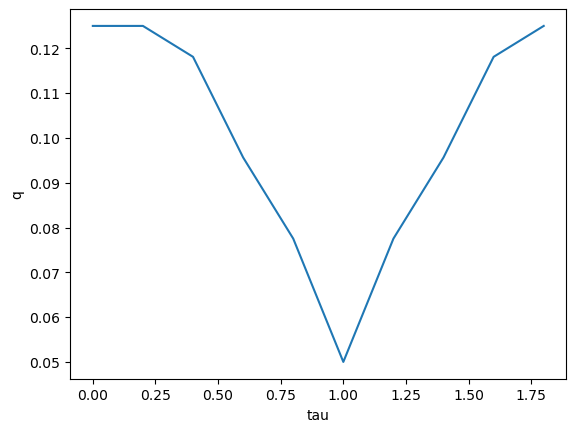

In [168]:
delayfactors = 0:9
qs = zeros(10)
for i = 1:10
    x, allρ, qs[i], numperiods = trafficflow_delay(1,1,0.5,"Godunov", delayfactors[i])
end
taus = delayfactors .* 2/10

clf()
fig, ax = subplots()
ax.plot(taus, qs)
ax.set_xlabel("tau")
ax.set_ylabel("q")
gcf()

In [171]:
x, allρ, q, numperiods = trafficflow_delay(1,1,0.5,"Godunov", 9)
display(q)
display(numperiods)
mkanim(x, allρ, axis = [-2,2,-0.1,1.1])

0.12499999999999999

3

PyObject <IPython.core.display.HTML object>